# 1.Introduction to Data Modeling


## Data modeling

Designing data and making it available across the organisation

Modeling process: From conceptual --> logical --> to physical


each table represents an entity type (customer, claim,..)

database - relational model

row = tuple

column = attribute

table = relation


##### RDBMS = SW system that manages relational db


##### Use of relational db (SQL): 

SQL, JOINS, AGGREG, flexibility, secondary indexes available, data integrity, standard query language, simplicity, ACID transactions (properties of db transactions intended to guarantee validity even in the evemt of errors, power fialures - all or nothing approach, column type rules, queries wait in rows until the previous trnasaction is completed, transactions are always saved once executed)

##### Non Relational db (NoSQL, since 2000): 

large amounts, speed and performance,  different data types,fast reads, flexible schema and columns, high availbity, horizontal scalability, low latency for distributed users geographically (different servers), however no acid transactions, no joins, no aggreg, not suitable for changing business requirements

-Apache Cassandra (Partition Row Store organized in columns and rows, linear scalability by adding nodes), MongoDB (Document Store), DynamoDB (Key-Value), apache HBase (Wide Column Store), Neo4J (Graph DB in form of nodes and edges) 

Use cases of NoSQL:

Transaction logging (retail, health care)

Internet of Things (IoT)

Time series data

Any workload that is heavy on writes to the database (since Apache Cassandra is optimized for writes).


### PostgreSQL

`import psycopg2`

 
`conn.set_session(autocommit=True)`


### Apache Cassandra

`import cassandra`


 Create a connection to the database


```
from cassandra.cluster import Cluster

try: 
    cluster = Cluster(['127.0.0.1'])
    ```


If you have a locally installed Apache Cassandra instance


```session = cluster.connect()
except Exception as e:
    print(e)```


TO-DO: Create the keyspace

```try:
    session.execute("""
    CREATE KEYSPACE IF NOT EXISTS ##### 
    WITH REPLICATION = 
    { 'class' : 'SimpleStrategy', 'replication_factor' : 1 }"""
)
except Exception as e:
    print(e)```

TO-DO: Connect to the Keyspace

```try:
    session.set_keyspace('#####')
except Exception as e:
    print(e)```

TO-DO: You need to create a table to be able to run the following query: `select * from songs WHERE year=1970 AND artist_name="The Beatles"`

```query = "CREATE TABLE IF NOT EXISTS ##### "
query = query + "(##### PRIMARY KEY (year, #####))"
try:
    session.execute(query)
except Exception as e:
    print(e)```

## Databases

OLAP (online analytical processing): omplex analytics and ad hoc queries

OLTP (Online trnsactional processing): less complex queries in large volumes - read, insert, update, delete

### Structuring the DB

### Normalization: 

##### Reduce data redundancy(copies) and increase integrity (having one source of truth in one place)


#### How to reach First Normal Form (1NF):

Atomic values: each cell contains unique and single values
Be able to add data without altering tables
Separate different relations into different tables
Keep relationships between tables together with foreign keys

#### Second Normal Form (2NF):

Have reached 1NF
All columns in the table must rely on the Primary Key


#### Third Normal Form (3NF):

Must be in 2nd Normal Form
No transitive dependencies
Remember, transitive dependencies you are trying to maintain is that to get from A-> C, you want to avoid going through B.


When to use 3NF:

When you want to update data, we want to be able to do in just 1 place. We want to avoid updating the table in the Customers Detail table (in the example in the lecture slide).


### Denormalization:

##### Read heavy worloads (duplicating information to allow faster querying without joining too many tables each of which contains detailed infoS)

Normalization is about trying to increase data integrity by reducing the number of copies of the data. Data that needs to be added or updated will be done in as few places as possible.

Denormalization is trying to increase performance by reducing the number of joins between tables (as joins can be slow). Data integrity will take a bit of a potential hit, as there will be more copies of the data (to reduce JOINS).


## Schemas & Statements

#### Star Schema
one or more fact tables referencing to dimension tables, benefits from denormalized tables, simplifies queries, allows fast aggregations, but ight face data integrity issues - duplicated info in several tables that requires updating, also this schema decreases query flexibility and has many to many relationships 

#### Snowflake Schema
multidimensional tables, multiple levels of relationships (tables deriving from tables), it's  more normalized



Star/snowflake schemas = for analytical purposes, as a copy of transactional db in a DW - denormalizezd).

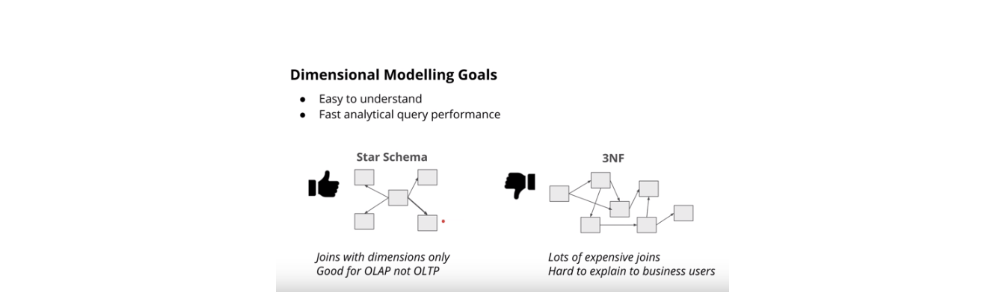

#### Primary Key

The *PRIMARY KEY* constraint is defined on a single column, and every table should contain a primary key. The values in this column uniquely identify the rows in the table. If a group of columns are defined as a primary key, they are called a composite key. That means the combination of values in these columns will uniquely identify the rows in the table. By default, the PRIMARY KEY constraint has the unique and not null constraint built into it.

Let's look at the following example:

```
CREATE TABLE IF NOT EXISTS store (
    store_id int PRIMARY KEY, 
    store_location_city text,
    store_location_state text
);
```

Here is an example for a group of columns serving as composite key.

```
CREATE TABLE IF NOT EXISTS customer_transactions (
    customer_id int, 
    store_id int, 
    spent numeric,
    PRIMARY KEY (customer_id, store_id)
);
```

#### Upsert

In RDBMS language, the term *upsert* refers to the idea of inserting a new row in an existing table, or updating the row if it already exists in the table. The action of updating or inserting has been described as "upsert".

The way this is handled in PostgreSQL is by using the INSERT statement in combination with the ON CONFLICT clause.

Example:

```INSERT into customer_address (
VALUES
    (432, '758 Main Street', 'Chicago', 'IL'
);```

Now let's assume that the customer moved and we need to update the customer's address. However we do not want to add a new customer id. In other words, if there is any conflict on the customer_id, we do not want that to change.

This would be a good candidate for using the ON CONFLICT DO NOTHING clause.

```INSERT INTO customer_address (customer_id, customer_street, customer_city, customer_state)
VALUES
 (
 432, '923 Knox Street', 'Albany', 'NY'
 ) 
ON CONFLICT (customer_id) 
DO NOTHING;```

Now, let's imagine we want to add more details in the existing address for an existing customer. This would be a good candidate for using the ON CONFLICT DO UPDATE clause.

```INSERT INTO customer_address (customer_id, customer_street)
VALUES
    (
    432, '923 Knox Street, Suite 1' 
) 
ON CONFLICT (customer_id) 
DO UPDATE
    SET customer_street  = EXCLUDED.customer_street;```




#### Performance Optimization

OLAP:

- roll up: instead of cities looking at countries
- drill down: instead of cities looking at districts 
- slice: decreasing dimensions
- dice: smaller cube ('where' clause)


`GROUP BY CUBE(movie, branch, month)` 


results into the same as:


`GROUP BY  GROUPING SETS ( (), month, country, (month, country))`


ALthough: before running group by  cube/grouping setes drop all none values as 'None'  int he output has a special meaning (grouped by nothing).

OLAP cubes can be stored for analytical purposes in a non-rel. db (MOLAP - multidimansional OLAP).


Or can be run on fly (ROLAP)


# 3. Data Warehouse

Is a cpoy of transactional data structured in a way optimal for data analysis

Retrieves data continuosly, keeps history, updated in batches, allows BI

Operational data/db (OLTP) 

--> 

ETL 

--> 

Warehouse (simple to understand, performant, secure) 

--> 

Analytical tools (OLAP Online Action Processes)


## AWS

Amazon Web Services
Amazon Web Services is one of the largest providers in the cloud computing industry, with over 140 services in compute, storage, databases, networking, developer tools, security, and more. In this lesson, we'll learn about a few essential tools and services in AWS and practice using them. These services can be accessed in three different ways: the AWS Management Console, the Command Line Interface (CLI), or Software Development Kits (SDKs), which can be used in combination.

We'll start with the AWS Management Console, which is the web user interface. The AWS CLI is a useful way to control and automate your services with code, and SDKs allow you to easily integrate services with your applications through APIs built around specific languages and platforms.



#### Create IAM role  https://console.aws.amazon.com/iam/.

#### Create security group

#### Launch cluster  https://console.aws.amazon.com/redshift/home?region=us-east-1

#### Create IAM User

#### Delete a Redshift Cluster 

(Make sure to delete your cluster each time you're finished working to avoid large, unexpected costs. You can always launch a new cluster, so don't leave it running overnight or throughout the week if you don't need to.)

#### Create an S3 bucket https://console.aws.amazon.com/s3/

(Specify public access settings for this bucket. For example, unchecking all of these boxes would allow anyone to be able to access this bucket. Be careful with this - you may end up having to pay lots of fees in data transfers from your bucket if you share this link and many people access large amounts of data with it. For this demo, we will leave all of these boxes checked.)

#### Create a PostgreSQL DB Instance using RDS https://console.aws.amazon.com/rds/

(For DB instance class, select db.t2.small, For DB instance identifier, enter postgreSQL-test or another name of your choice, In the Backup section and select 1 day since this is for demonstration purposes.)



### Key recommendations for using your AWS credits wisely:
Delete your Amazon Redshift cluster each time you're finished working.
Use a smaller subset of your data while you code and debug on AWS, and only execute with the full dataset on AWS as a final test of your code.




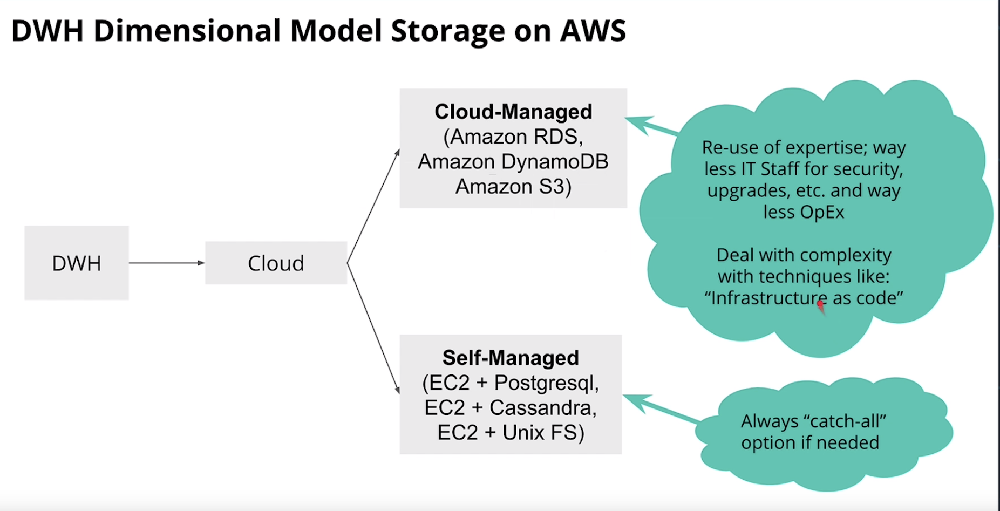

An EC2 instance is a virtual server in Amazon's Elastic Compute Cloud (EC2) for running applications on the Amazon Web Services (AWS) infrastructure. 

RDS= relational db system

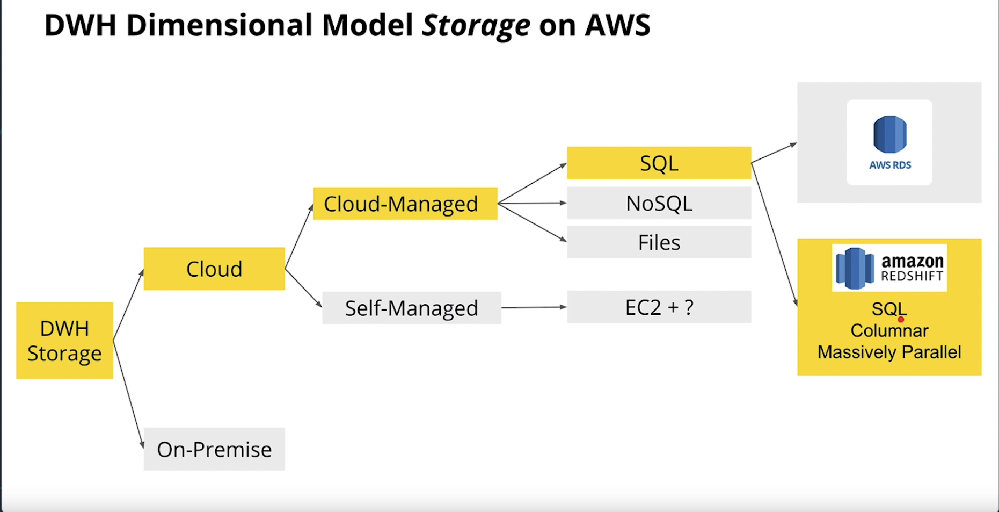

Normally, on most db each query runs on a separate cpu/core. With the MPP approach (massively parallel), each table is partitioned and dsitributed over multiple cpu-s and processed in parallel.

Amazon Redshift is MPP, cloud managed, column-oriented.


Redshift = cluster consisting on a leader node that communicates with the client and optimizes the query execution + compute nodes (each being sliced in multiple cpu-s)


* The total number of nodes in a Redshift cluster is equal to number of aws EC2 instances used in the cluster*





## ETL

SQL to SQL ETL when creating new tables/views across different servers/dbs requires lots of storage in between. Therefore we can connect Amazon RDS to buckets and move over redshift through EC2 machines.

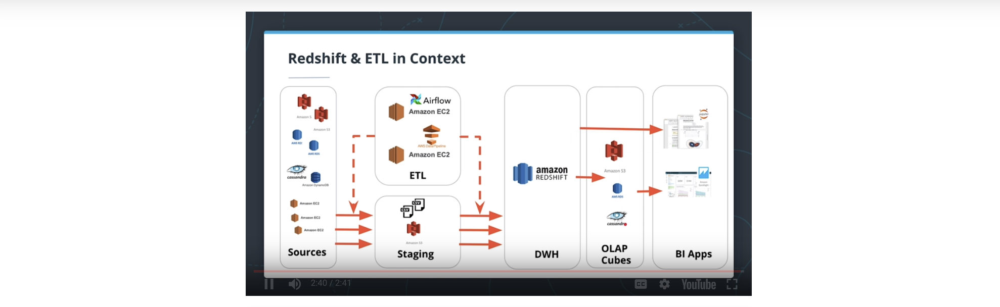

before inserting the data from S3 buskets to Redshift we manipulate and clean it

https://www.youtube.com/watch?time_continue=47&v=maAfudoixmE

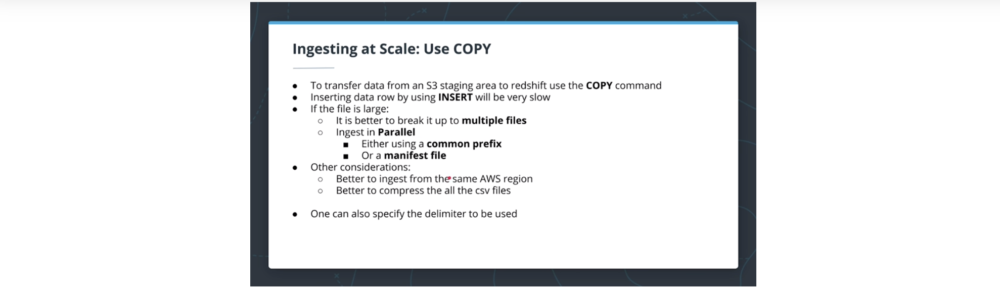

The copy command is faster over insert command and compresses data too

https://www.youtube.com/watch?time_continue=24&v=i3a71j8mNjI


With the command unload we can feed data to BI apps


Since the files have a common suffix and not a common prefix, we actually need to create a manifest specifying the list of files. If they were named:


s3://mySource/sales-day1.csv.gz

s3://mySource/sales-day2.csv.gz

We could have relied on the existence of a common prefix.




In order for Amazon Redshift to get the data from S3 and access it, we have to create an IAM role with the read access policy/privilege. To access this Redshift warehouse from the outside (jupyter notebook or BI apps) we have to open a TCP port on Redshift (lower a bit the seucrity settings).


##### IaC (infrastructure as code:e.g. through cli or Amazon SDK) 
-- > we have to create a user with programmatic access



We will use python AWS SDK aka boto3 for this purpose (build the cluster and give privileges)

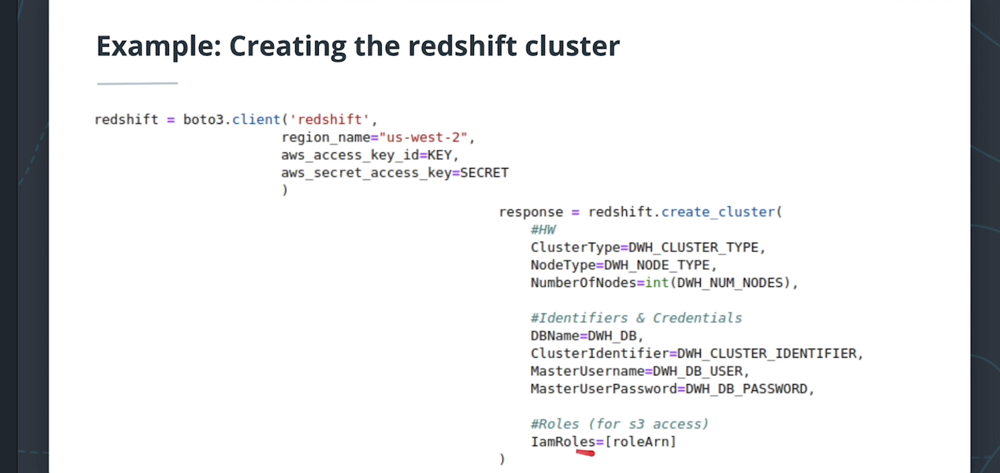

#### Distribution Style (partitioning of tables)
When copying the data into a table, following distribution styles can be applied:

Even (table partitioned in a way that every row ends up on a different partition)

All (Broadcasting - making identical copies of the same table on all partitions)

Auto (Redshift choice depending on the table saze)

Key (similar values (rows with the same key) are placed in the same slice/partition): by using distkey or sortkey

Most db  = parallel execusion of queries while 1 query = 1 CPU. Redshift = MPP (massively parallel processing, single query partitioned over  several CPUs).

##### Redshift = Column Oriented

Scaling up the needs (choosing powerful CPUs) vs scaling out (getting more CPUs) are very possible and flexible with Redshift.


###### Data Flow with Amazon:

AWS relational db --> Amazon EC2 (ETL) or Amazon S3 buckets (for storage only) --> Amazon Redshift (DW).



# 4. Data Lakes

ELT (extract-load-transfer) not ETL


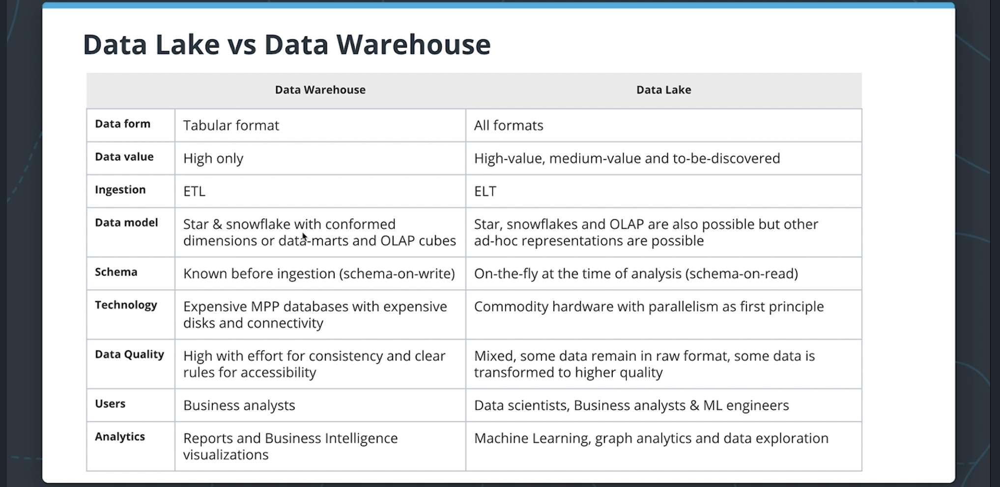

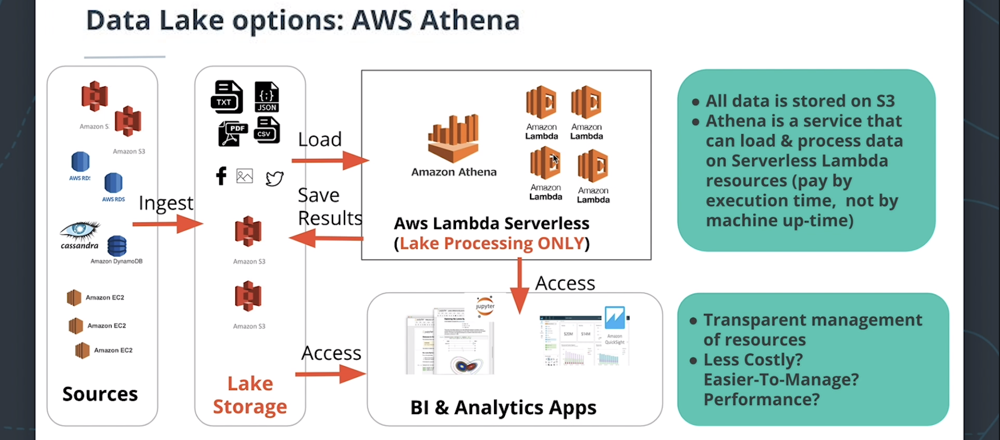

### Defining New Terms
The video above includes references to a few terms that you may not be familiar with. Below are some definitions that you might find useful.

##### Extract Transform Load (ETL) and Extract Load Transform (ELT):
"ETL is normally a continuous, ongoing process with a well-defined workflow. ETL first extracts data from homogeneous or heterogeneous data sources. Then, data is cleansed, enriched, transformed, and stored either back in the lake or in a data warehouse.

"ELT (Extract, Load, Transform) is a variant of ETL wherein the extracted data is first loaded into the target system. Transformations are performed after the data is loaded into the data warehouse. ELT typically works well when the target system is powerful enough to handle transformations. Analytical databases like Amazon Redshift and Google BigQ."

##### What is S3?
"Amazon S3 has a simple web services interface that you can use to store and retrieve any amount of data, at any time, from anywhere on the web. It gives any developer access to the same highly scalable, reliable, fast, inexpensive data storage infrastructure that Amazon uses to run its own global network of web sites."

##### What is Kafka?
"Apache Kafka is an open-source stream-processing software platform developed by Linkedin and donated to the Apache Software Foundation, written in Scala and Java. The project aims to provide a unified, high-throughput, low-latency platform for handling real-time data feeds. Its storage layer is essentially a massively scalable pub/sub message queue designed as a distributed transaction log, making it highly valuable for enterprise infrastructures to process streaming data."

##### What is RedShift?
"Amazon Redshift is a fully managed, petabyte-scale data warehouse service in the cloud. You can start with just a few hundred gigabytes of data and scale to a petabyte or more... The first step to create a data warehouse is to launch a set of nodes, called an Amazon Redshift cluster. After you provision your cluster, you can upload your data set and then perform data analysis queries. Regardless of the size of the data set, Amazon Redshift offers fast query performance using the same SQL-based tools and business intelligence applications that you use today.

So in other words, S3 is an example of the final data store where data might be loaded (e.g. ETL). While Redshift is an example of a data warehouse product, provided specifically by Amazon.



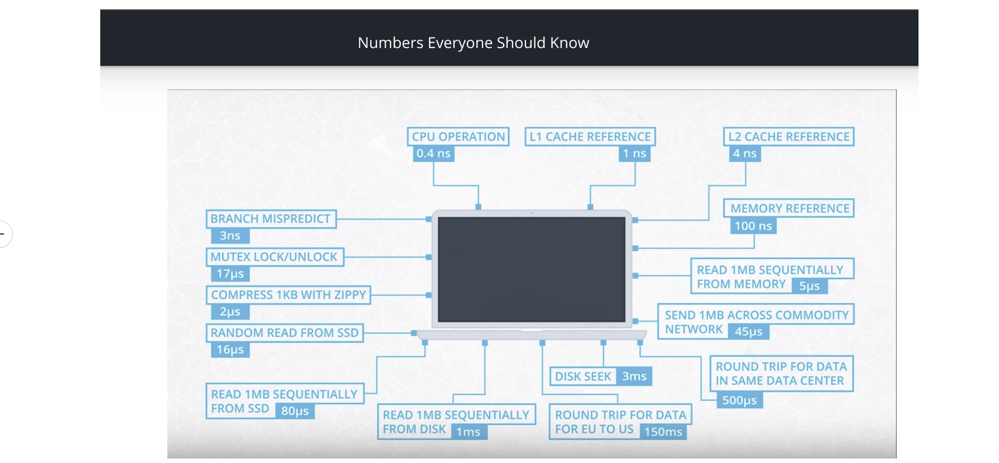




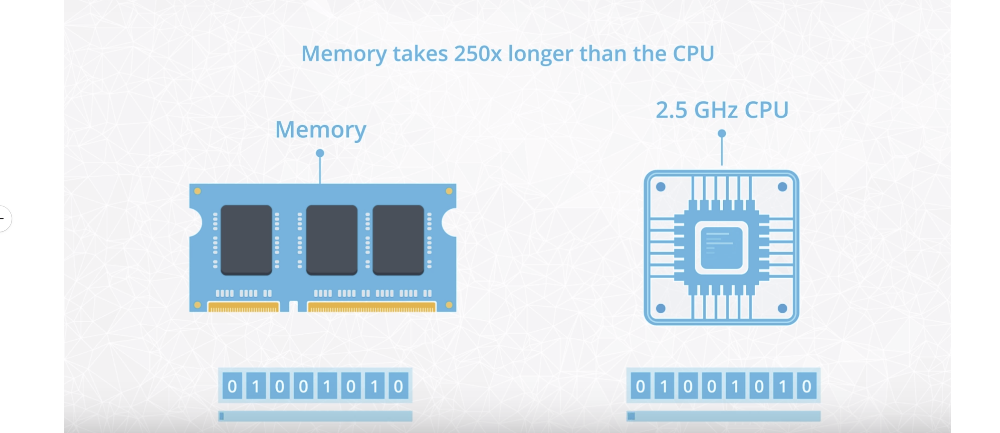

At a high level, distributed computing implies multiple CPUs each with its own memory. Parallel computing uses multiple CPUs sharing the same memory.


DW vs Lake: DW = very structured, lakes were created later with the new technologies and social media dumping unstructured data all over that can be handled in data lakes. It's time costly in tranforming all the unstructured data in the tbaular format and saving them in the DW. 

### 4.1 Hadoop  & Spark


Hadoop - an ecosystem of tools for big data storage and data analysis. Hadoop is an older system than Spark but is still used by many companies. The major difference between Spark and Hadoop is how they use memory. Hadoop writes intermediate results to disk whereas Spark tries to keep data in memory whenever possible. This makes Spark faster for many use cases.


Hadoop MapReduce - a system for processing and analyzing large data sets in parallel. Maps data from HDFS based on key values and pairs, shuffles the data so that the same keys and pairs end up on the same machine, reduces (combines/sums the values per each key so that it limits the number of pairs).


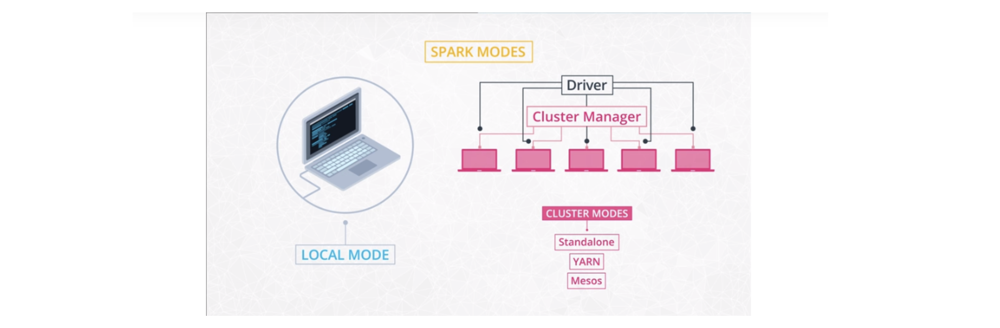


##### To run MapReduce jobs with Python, install mrjob library


MapReduce is a programming technique for manipulating large data sets. "Hadoop MapReduce" is a specific implementation of this programming technique.


The technique works by first dividing up a large dataset and distributing the data across a cluster. In the map step, each data is analyzed and converted into a (key, value) pair. Then these key-value pairs are shuffled across the cluster so that all keys are on the same machine. In the reduce step, the values with the same keys are combined together.


While Spark doesn't implement MapReduce, you can write Spark programs that behave in a similar way to the map-reduce paradigm.

The biggest difference between Hadoop and Spark is that Spark tries to do as many calculations as possible in memory, which avoids moving data back and forth across a cluster. Hadoop writes intermediate calculations out to disk, which can be less efficient. Hadoop is an older technology than Spark and one of the cornerstone big data technologies.



Hadoop YARN - a resource manager that schedules jobs across a cluster. The manager keeps track of what computer resources are available and then assigns those resources to specific tasks.


Hadoop Distributed File System (HDFS) - a big data storage system that splits data into chunks and stores the chunks across a cluster of computers.


As Hadoop matured, other tools were developed to make Hadoop easier to work with. These tools included:


Apache Pig - a SQL-like language that runs on top of Hadoop MapReduce


Apache Hive - another SQL-like interface that runs on top of Hadoop MapReduce


Oftentimes when someone is talking about Hadoop in general terms, they are actually talking about Hadoop MapReduce. However, Hadoop is more than just MapReduce. In the next part of the lesson, you'll learn more about how MapReduce works.


```
%%file wordcount.py
# %%file is an Ipython magic function that saves the code cell as a file
from mrjob.job import MRJob # import the mrjob library
class MRSongCount(MRJob):
    
    # the map step: each line in the txt file is read as a key, value pair
    # in this case, each line in the txt file only contains a value but no key
    # _ means that in this case, there is no key for each line
    def mapper(self, _, song):
        # output each line as a tuple of (song_names, 1) 
        yield (song, 1)
    # the reduce step: combine all tuples with the same key
    # in this case, the key is the song name
    # then sum all the values of the tuple, which will give the total song plays
    def reducer(self, key, values):
        yield (key, sum(values))
        
if __name__ == "__main__":
    MRSongCount.run()
```


##### How is Spark related to Hadoop?


Spark = big data framework. Spark contains libraries for data analysis, machine learning, graph analysis, and streaming live data (faster than Hadoop). This is because Hadoop writes intermediate results to disk whereas Spark tries to keep intermediate results in memory whenever possible.


The Hadoop ecosystem includes a distributed file storage system called HDFS (Hadoop Distributed File System). Spark, on the other hand, does not include a file storage system. You can use Spark on top of HDFS but you do not have to. Spark can read in data from other sources as well such as Amazon S3.

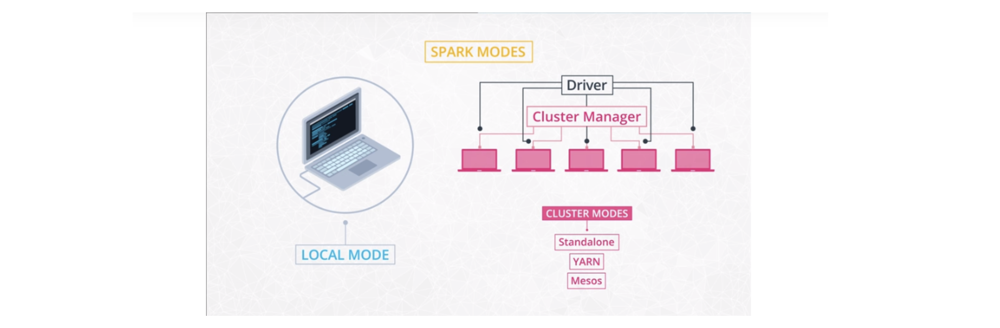


#### Streaming Data

Data streaming is a specialized topic in big data. The use case is when you want to store and analyze data in real-time such as Facebook posts or Twitter tweets.
Spark has a streaming library called Spark Streaming although it is not as popular and fast as some other streaming libraries. Other popular streaming libraries include Storm and Flink. 

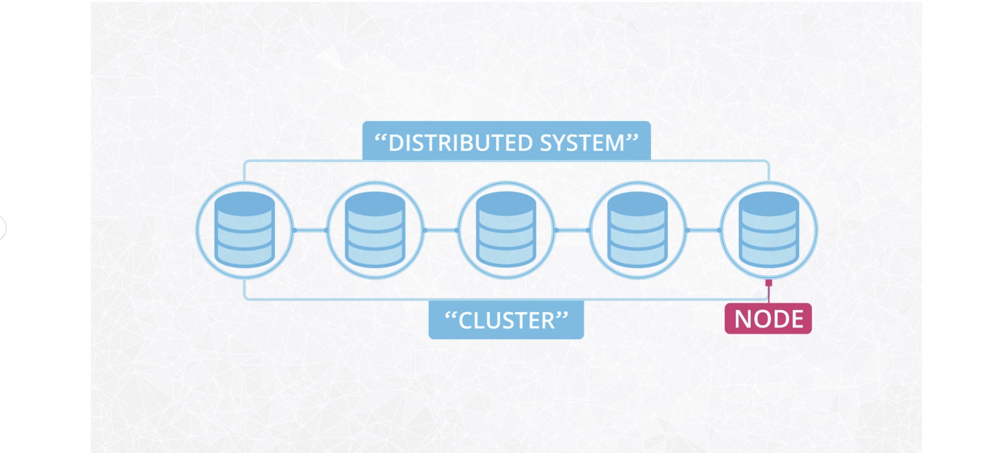

#### Spark Use Cases

You Don't Always Need Spark(when working on smaller data sets). Spark is meant for big data sets that cannot fit on one computer.

Spark's Limitations:


Spark Streaming's latency is at least 500 milliseconds since it operates on micro-batches of records, instead of processing one record at a time. Native streaming tools such as Storm, Apex, or Flink can push down this latency value and might be more suitable for low-latency applications. Flink and Apex can be used for batch computation as well, so if you're already using them for stream processing, there's no need to add Spark to your stack of technologies.


Another limitation of Spark is its selection of machine learning algorithms. Currently, Spark only supports algorithms that scale linearly with the input data size. In general, deep learning is not available either, though there are many projects integrate Spark with Tensorflow and other deep learning tools.


Spark is not a data storage system, and there are a number of tools besides Spark that can be used to process and analyze large datasets: SQL, NoSQL and NewSQL.


### 4.2 Data Wrangling and Debugging With Spark

Web UI helps to monitor the proceses, jobs and status of Spark clusters (runs on port 8080)

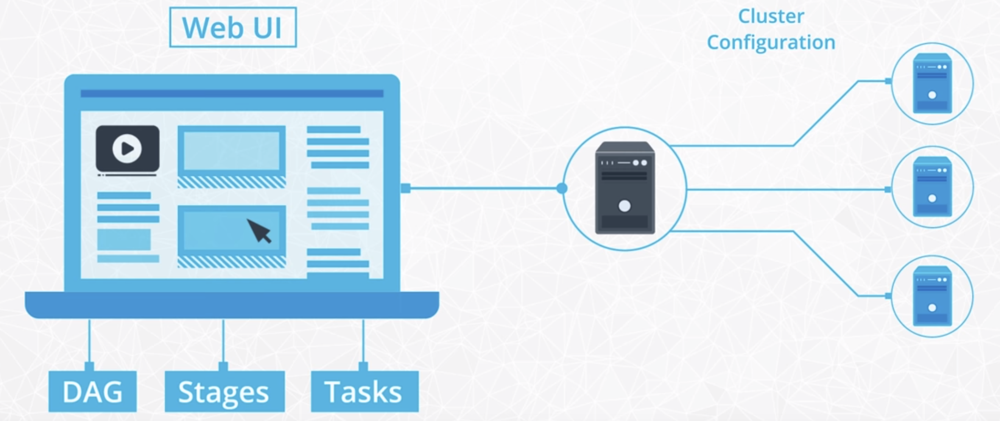

If you run into out of memory errors you might consider increasing the number of partitions. If the memory errors occur over time you can look into why the size of certain objects is increasing too much during the run and if the size can be contained. Also, look for ways of freeing up resources if garbage collection metrics are high.

##### Data skew

The problem with data skew is that it’s very specific to a data set. You might know ahead of time that certain customers or accounts are expected to generate a lot more activity but the solution for dealing with the skew might strongly depend on how the data looks like


If you drill down on the Spark UI to the task level you can see if certain partitions process significantly more data than others and if they are lagging behind. Such symptoms usually indicate a skewed data set. Consider implementing the techniques mentioned in this lesson:

add an intermediate data processing step with an alternative key
adjust the spark.sql.shuffle.partitions parameter if necessary


##### Inefficient queries

Once your Spark application works it’s worth spending some time to analyze the query it runs. You can use the Spark UI to check the DAG and the jobs and stages it’s built of.

Spark’s query optimizer is called Catalyst. While Catalyst is a powerful tool to turn Python code to an optimized query plan that can run on the JVM it has some limitations when optimizing your code. It will for example push filters in a particular stage as early as possible in the plan but won’t move a filter across stages. It’s your job to make sure that if early filtering is possible without compromising the business logic than you perform this filtering where it’s more appropriate.

It also can’t decide for you how much data you’re shuffling across the cluster. Remember from the first lesson how expensive sending data through the network is. As much as possible try to avoid shuffling unnecessary data. In practice, this means that you need to perform joins and grouped aggregations as late as possible.

When it comes to joins there is more than one strategy to choose from. If one of your data frames are small consider using broadcast hash join instead of a hash join.

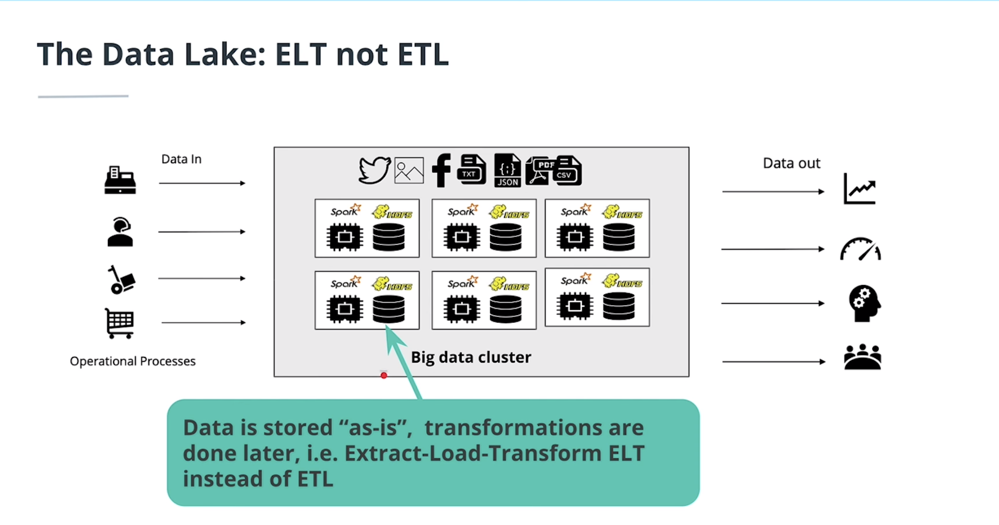

Data lakes: data is stored and processed in one place (spark+hadoop e.g., extremely parralel, parquet columnar storage) and is processed by schema on read, without creating any star schemas in before hand

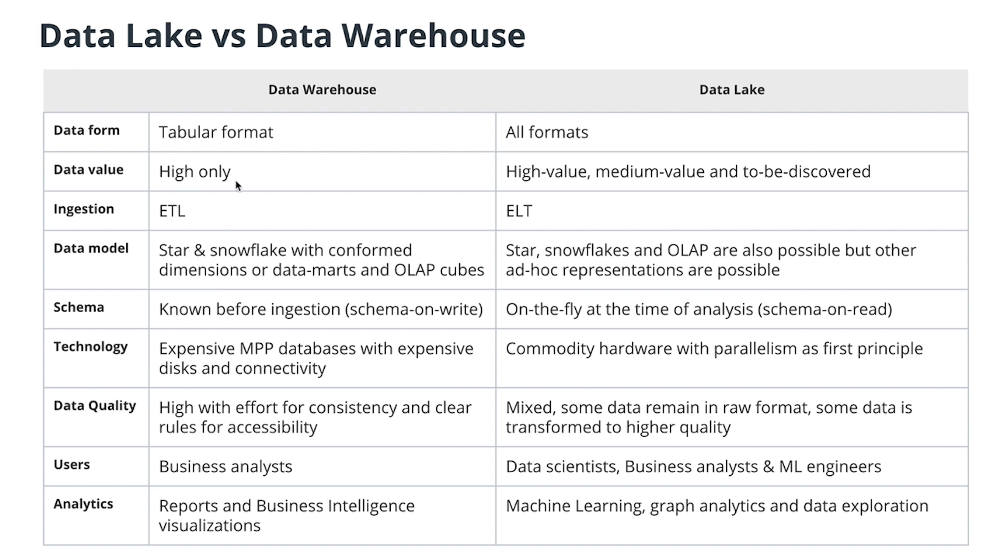

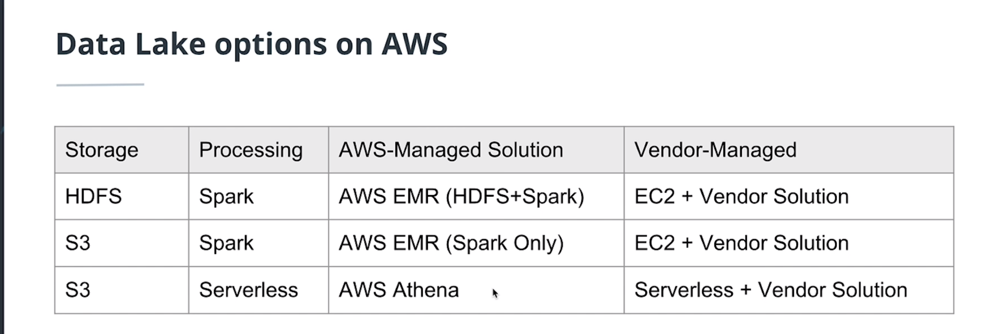

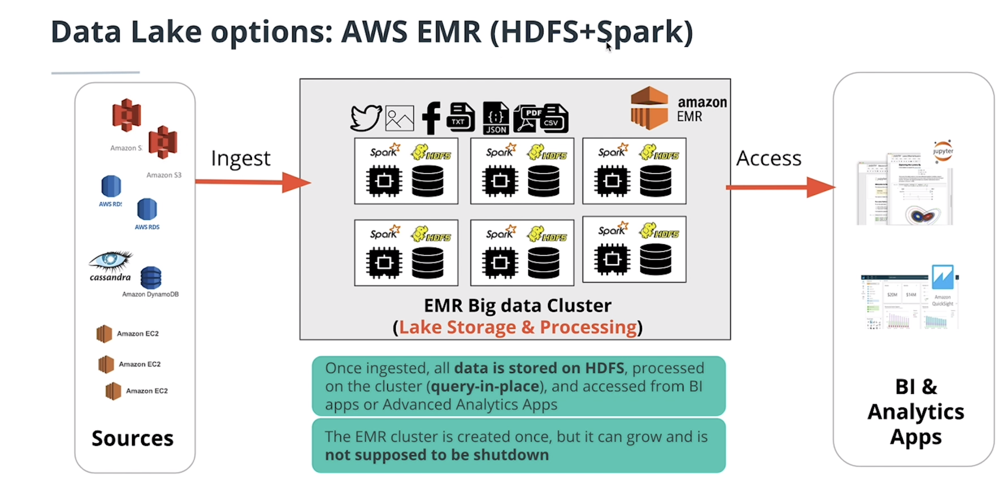



Here up we pay the  cost of all the EC2 machine on which the EMR cluster is running. The cluster is 24/7 life and running, costing us money. On the other hand, S3 is serverless. If we use S3 as a data lake, we can still use the EMR cluster for dat processing but it's not running constantly, we can shut it down anytime and only run if a data processing job is needed. Everything lives on S3. It's less performant but still performant enough and is safe. EMR takes care of system administration but it


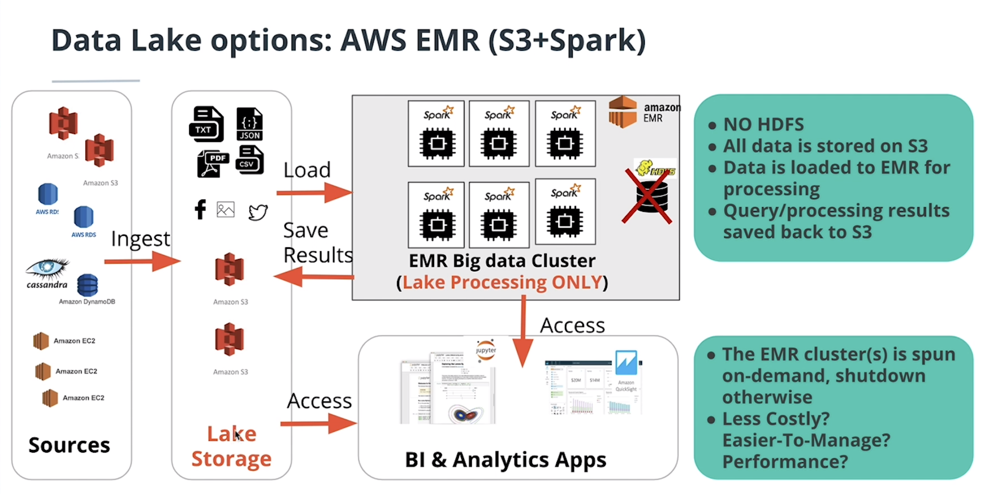

3rd option is a very cloud native option: Athena and Lambda (function as a service - you don't set up an EC2 machine or anything. Just run the function no matter what is being run in the cloud. Only pay per run)


For small computational jobs lambda > ec2 > EMR


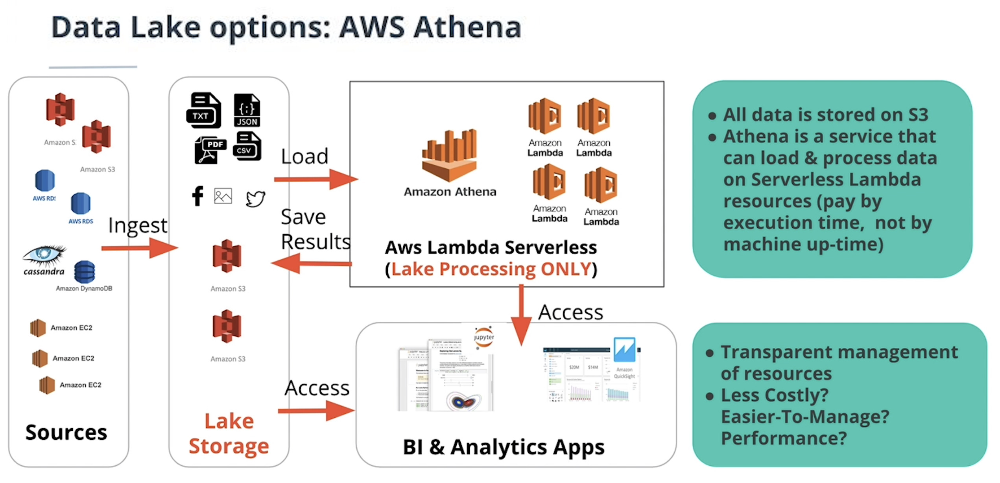

###### Powerful Spark types: struct (json e.g.), array, map

# 5. Data Pipelines



## Data Validation 
### Techniques:

Validate that all the little groups of data have mean > 0

Validate that number of rows in our output table = number of rows in the input table (e.g. S3)

Dataset assessment


## DAGs Directed Acyclic Graphs

= entities and relationships between them (like data pipelines, networks)

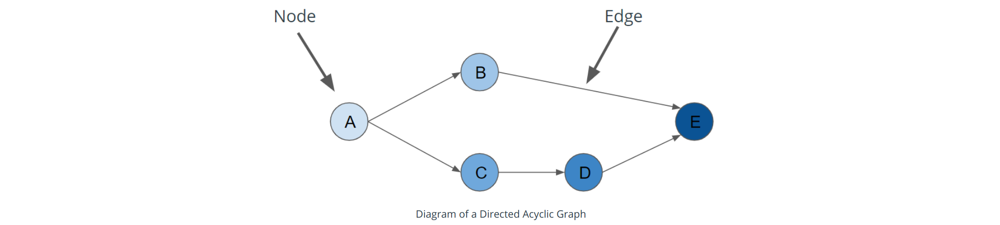

DAGs are a special subset of graphs in which the edges between nodes have a specific direction, and no cycles exist. When we say “no cycles exist” what we mean is the nodes cant create a path back to themselves.

Nodes: A step in the data pipeline process.

Edges: The dependencies or relationships other between nodes.

However, it's not uncommon for a data pipeline to take the same dataset, perform two different processes to analyze the it, then merge the results of those two processes back together.


## Apache Airflow

how all the steps of DAGs click together
written in python

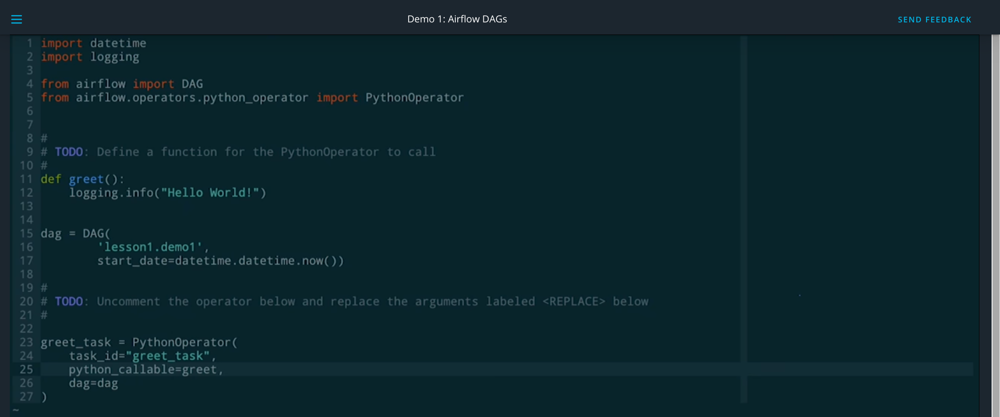

Airflow takes few secs to process changes in the code

Instalation: https://airflow.apache.org/docs/stable/start.html